# ECE-6524 / CS-6524 Deep Learning
# Assignment 5 (110 pts)

In this assignment, **you will implement the following:**
1. GAN / LSGAN loss functions and training code for MNIST dataset.
2. Train GAN / LSGAN on CelebA dataset with DCGAN architecture.

**<span style="color:red">Again, it may take hours to train on CelebA. So start early.</span>** (We don't want you to work during holidays)

## Submission guideline for the coding part (Jupyter Notebook)

1. Click the Save button at the top of the Jupyter Notebook
2. Please make sure to have entered your Virginia Tech PID below
3. Once you've completed everything (make sure output for all cells are visible), select File -> Download as -> PDF via LaTeX
4. Look at the PDF file and make sure all your solutions are displayed correctly there 
7. Zip this notebook (Please don't include the data). Name it as Assignment_3_Code_[YOUR PID NUMBER].zip
8. Name your PDF file as Assignment_4_NB_[YOUR PID NUMBER].pdf
9. **<span style="color:blue"> Submit your zipped file and the PDF SEPARATELY**</span>

Note: if facing issues with step 3 refer: https://pypi.org/project/notebook-as-pdf/

## Submission guideline for the coding part (Google Colab)

1. Click the Save button at the top of the Notebook
2. Please make sure to have entered your Virginia Tech PID below
3. Follow last two cells in this notebook for guidelines to download pdf file of this notebook
4. Look at the PDF file and make sure all your solutions are displayed correctly there 
5. Zip this notebook (Please don't include the data). Name it as Assignment_2_Code_[YOUR PID NUMBER].zip
6. Name your PDF file as Assignment_4_NB_[YOUR PID NUMBER].pdf
7. **<span style="color:blue"> Submit your zipped file and the PDF SEPARATELY**</span>

**While you are encouraged to discuss with your peers, <span style="color:blue">all work submitted is expected to be your own.</span> <span style="color:red">If you use any information from other resources (e.g. online materials), you are required to cite it below you VT PID. Any violation will result in a 0 mark for the assignment.</span>**

### Colab Setup: 
- Below are some basic steps for colab setup. 
- Make changes based on requirements.
- Comment out in case of ARC or your local device with powerful GPU.

from google.colab import drive
drive.mount('/content/drive')

In [1]:
import sys
# modify "path_to_homework", path of folder in drive, where you uploaded your homework files
path_to_homework = "/home/juvekaradheesh/repositories/DL-Course-Assignments/Assignment_5/"
sys.path.append(path_to_homework)

# Section 1. Generative Adversarial Networks on MNIST Dataset [54 pts]

In this section, you will need to:
1. Implement two different types of loss functions (GAN / LSGAN) for generative adversarial networks. 
2. Build the Discriminator and Generator.
3. Implement training codes for your GAN models.
3. Train your model on MNIST dataset and visualize the generated images.

Now, let's get started!

In [2]:
import torch
import torch.nn as nn
from torchvision import datasets
from torchvision import transforms
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder

import numpy as np
import os

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [3]:
def show_images(images, color=False):
    if color:
        sqrtimg = int(np.ceil(np.sqrt(images.shape[2]*images.shape[3])))
    else:
        images = np.reshape(images, [images.shape[0], -1])  # images reshape to (batch_size, D)
        sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))


    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        if color:
            plt.imshow(np.swapaxes(np.swapaxes(img, 0, 1), 1, 2))
        else:
            plt.imshow(img.reshape([sqrtimg,sqrtimg]))
    return 

def preprocess_img(x):
    return 2 * x - 1.0

def deprocess_img(x):
    return (x + 1.0) / 2.0

def rel_error(x,y):
    return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

def sample_noise(batch_size, dim):
    """
    Generate a PyTorch Tensor of uniform random noise.

    Input:
    - batch_size: Integer giving the batch size of noise to generate.
    - dim: Integer giving the dimension of noise to generate.
    
    Output:
    - A PyTorch Tensor of shape (batch_size, dim) containing uniform
      random noise in the range (-1, 1).
    """
    to_return = torch.randn((batch_size, dim))
    return to_return/torch.max(to_return)

In [4]:
# set your device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

## Section 1.1. Vanilla GAN loss functions

### Section 1.1.1 GAN Loss [10 pts]
We start from implementing the vanilla GAN loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). Specifically, you need to complete the `generator_loss` and `discriminator_loss` in the cell below.

Recalled from the class, the generator loss is written as:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these equations could be silghtly different from what we have seen before. This is because that in Pytorch, our optimize will be *minimizing* the loss functions. As a result, we negate the formulas to match pytorch's behavior.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [5]:
def discriminator_loss(logits_real, logits_fake):
    """
    Computes the discriminator loss.
 
    You should use the stable torch.nn.functional.binary_cross_entropy_with_logits
    loss rather than using a separate softmax function followed by the binary cross
    entropy loss.
 
    Inputs:
    - logits_real: PyTorch Tensor of shape (N,) giving scores for the real data.
    - logits_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
 
    Returns:
    - loss: PyTorch Tensor containing (scalar) the loss for the discriminator.
    """
 
    loss = None
    
    ####################################
    #          YOUR CODE HERE          #
    ####################################
    loss_fn = nn.functional.binary_cross_entropy_with_logits
    
    shape = (logits_real.shape[0], logits_real.shape[1])
    
    loss_real = loss_fn(logits_real, torch.ones(shape, device=device))
    
    loss_fake = loss_fn(logits_fake, torch.zeros(shape, device=device))
    
    loss = loss_real + loss_fake

    ##########       END      ##########
    return loss

def generator_loss(logits_fake):
    """
    Computes the generator loss.

    You should use the stable torch.nn.functional.binary_cross_entropy_with_logits
    loss rather than using a separate softmax function followed by the binary cross
    entropy loss.

    Inputs:
    - logits_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
    
    Returns:
    - loss: PyTorch Tensor containing the (scalar) loss for the generator.
    """

    loss = None
 
    ####################################
    #          YOUR CODE HERE          #
    ####################################
    
    loss_fn = nn.functional.binary_cross_entropy_with_logits
    
    shape = (logits_fake.shape[0], logits_fake.shape[1])
    
    loss = loss_fn(logits_fake, torch.ones(shape, device=device))
    
    ##########       END      ##########
    return loss

### Section 1.1.2 Build simple model [10 pts]

Build your simple model using below layers:

**Discriminator:**

- Flatten input (flatten the C x H x W into a single vector per image)
- linear (784, 256)
- Leaky ReLU ()
- Linear(256, 256)
- Leaky ReLU()
- Linear(256, 1)

**Generator:**
- Linear(noise_dim, 1024)
- ReLU()
- Linear(1024, 1024)
- ReLU()
- linear(1024, 784)
- Tanh()

In [6]:
NOISE_DIM = 100

def discriminator():
    """
    Initialize and return a simple discriminator model.
    """
    # Your code here:
    model = nn.Sequential(
        nn.Linear(784, 256),
        nn.LeakyReLU(),
        nn.Linear(256, 256),
        nn.LeakyReLU(),
        nn.Linear(256, 1)
    )
    return model

def generator(noise_dim=NOISE_DIM):
    """
    Initialize and return a simple generator model.
    """
    # Your code here:
    model = nn.Sequential(
        nn.Linear(noise_dim, 1024),
        nn.ReLU(),
        nn.Linear(1024, 1024),
        nn.ReLU(),
        nn.Linear(1024, 784),
        nn.Tanh()
    )
    return model

### Section 1.1.3 Training code [10 pts]
You can't train a model without a proper training code. Implement the GAN training procedure here following the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf) and the course slides in the cell below. Note that this code would be reused in the subsequent section, so make sure that it is correctly implemented.

In [7]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
 
def train(D, G, D_solver, G_solver, discriminator_loss, generator_loss, show_every=250, 
          ckpt_dir = path_to_homework + '/ckpts/Vanilla_gan_MINST/', cont_train=False,
          batch_size=128, noise_size=100, num_epochs=10, train_loader=None, device=None):
    """
    Train loop for GAN.

    The loop will consist of two steps: a discriminator step and a generator step.

    (1) In the discriminator step, you should zero gradients in the discriminator
    and sample noise to generate a fake data batch using the generator. Flatten real images 
    to 784 (28 * 28). Calculate the discriminator output for real and fake data, 
    and use the output to compute discriminator loss. Call backward() on the loss 
    output and take an optimizer step for the discriminator.

    (2) For the generator step, you should once again zero gradients in the generator
    and sample noise to generate a fake data batch. Get the discriminator output
    for the fake data batch and use this to compute the generator loss. Once again
    call backward() on the loss and take an optimizer step.

    You will need to reshape the fake image tensor outputted by the generator to
    be dimensions (batch_size x input_channels x img_size x img_size).

    Use the sample_noise function to sample random noise, and the discriminator_loss
    and generator_loss functions for their respective loss computations

    Inputs:
    - D, G: PyTorch models for the discriminator and generator
    - D_solver, G_solver: torch.optim Optimizers to use for training the
      discriminator and generator.
    - discriminator_loss, generator_loss: Functions to use for computing the generator and
      discriminator loss, respectively.
    - show_every: Show samples after every show_every iterations.
    - batch_size: Batch size to use for training.
    - noise_size: Dimension of the noise to use as input to the generator.
    - num_epochs: Number of epochs over the training dataset to use for training.
    - train_loader: image dataloader
    - device: PyTorch device
    """
    if os.path.exists(os.path.join(ckpt_dir, 'checkpoint.pth')) and cont_train:
        ckpt = torch.load(os.path.join(ckpt_dir, 'checkpoint.pth'))
        start_epoch = ckpt['epoch'] + 1
        iter_count = ckpt['iter_count'] + 1
        G.load_state_dict(ckpt['G'])
        D.load_state_dict(ckpt['D'])
        print('Start from a checkpoint: {}, epoch:{}, iter:{}'.format(os.path.join(ckpt_dir, 'checkpoint.pth'), 
                                                 str(start_epoch), str(iter_count)))
    else:
        start_epoch = 0
        iter_count = 0
        
    for epoch in range(start_epoch, num_epochs):
        print('EPOCH: ', (epoch+1))
        for x, _ in train_loader:
            _, input_channels, img_size, _ = x.shape

            real_images = preprocess_img(x).to(device)  # normalize

            # Store discriminator loss output, generator loss output, and fake image output
            # in these variables for logging and visualization below
            d_error = None
            g_error = None
            fake_images = None


            ####################################
            #        Discriminator step        #
            #          YOUR CODE HERE          #
            ####################################
            
            D_solver.zero_grad()
            noise = sample_noise(batch_size, noise_size).to(device)
            fake_images = G(noise)
            real_images = real_images.view(batch_size, -1)
            
            
            fake_output = D(fake_images)
            real_output = D(real_images)
            
            d_error = discriminator_loss(real_output, fake_output)
            
            d_error.backward()
            D_solver.step()
            
            #########       END      ###########
 
            ####################################
            #          Generator step          #
            #          YOUR CODE HERE          #
            ####################################
            
            G_solver.zero_grad()
            noise = sample_noise(batch_size, noise_size).to(device)
            fake_images = G(noise)
            d_output = D(fake_images)
            g_error = generator_loss(d_output)
            
            g_error.backward()
            G_solver.step()
            
            fake_images = fake_images.view(batch_size, input_channels, img_size, img_size)
            
            ##########       END      ##########
            if (iter_count % show_every == 0):
                print('Iter: {}, D: {:.4}, G:{:.4}'.format(iter_count,d_error.item(),g_error.item()))
                disp_fake_images = deprocess_img(fake_images.data)  # denormalize
                imgs_numpy = (disp_fake_images).cpu().numpy()
                show_images(imgs_numpy[0:16], color=input_channels!=1)
                plt.show()
                print()
            iter_count += 1
            
        # save checkpoints
        os.makedirs(ckpt_dir, exist_ok=True)
        print('Saving the model as a checkpoint...')
        torch.save({'epoch': epoch, 
                    'iter_count': iter_count,
                    'G': G.state_dict(), 
                    'D': D.state_dict()}, 
                   os.path.join(ckpt_dir, 'checkpoint.pth'))

MNIST is a simple dataset that contains one hand-written digit in each image. It is usually used for sanity check. So, let's test our loss functions and training code on it!

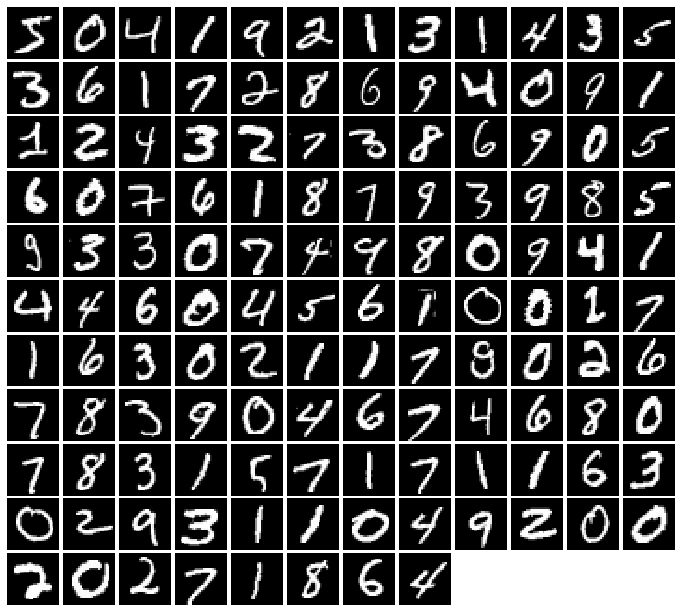

In [8]:
batch_size = 128

mnist = datasets.MNIST('./MNIST_data', train=True, download=True,
                           transform=transforms.ToTensor())
loader_train = DataLoader(mnist, batch_size=batch_size, drop_last=True)


imgs = loader_train.__iter__().next()[0].view(batch_size, 784).numpy().squeeze()
show_images(imgs)

### Section 1.1.4 Train your model [7 pts]

- Call Discriminator and Generator for training.
- Call optimizers for both discriminator and generator for training. (Use Adam with lr=1e-3, betas = (0.5, 0.999))
- Call train function to train. 
- Train for 10 epochs.

After training your GAN model, you should expect results that resemble the following if your loss function and training loop implementations are correct:

<img src="files/gan_samples/mnist_gan.jpg" width=300>
Refer mnist.jpg from gan_samples folder.

EPOCH:  1
Iter: 0, D: 1.356, G:0.6821


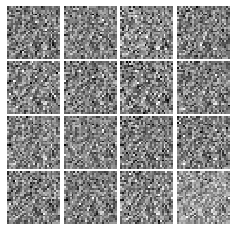


Iter: 250, D: 1.157, G:1.226


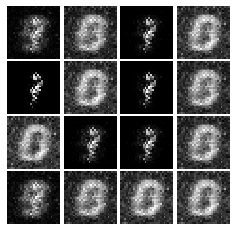


Saving the model as a checkpoint...
EPOCH:  2
Iter: 500, D: 1.272, G:1.439


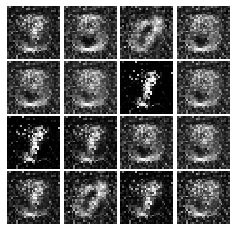


Iter: 750, D: 1.214, G:1.335


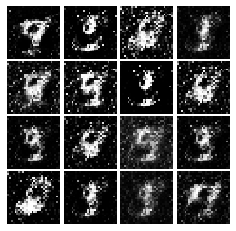


Saving the model as a checkpoint...
EPOCH:  3
Iter: 1000, D: 0.8878, G:1.533


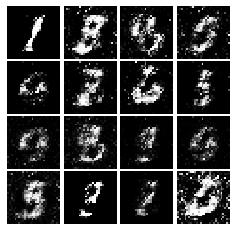


Iter: 1250, D: 0.9907, G:1.275


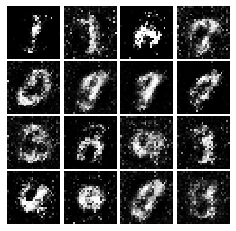


Saving the model as a checkpoint...
EPOCH:  4
Iter: 1500, D: 1.213, G:1.026


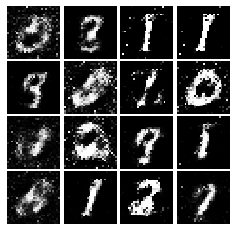


Iter: 1750, D: 1.174, G:0.9852


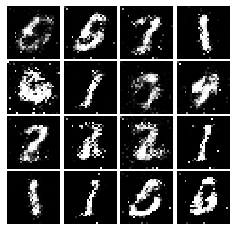


Saving the model as a checkpoint...
EPOCH:  5
Iter: 2000, D: 1.2, G:0.873


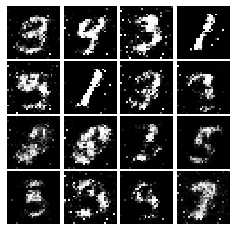


Iter: 2250, D: 1.181, G:0.9249


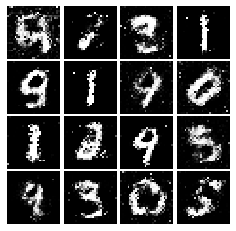


Saving the model as a checkpoint...
EPOCH:  6
Iter: 2500, D: 1.205, G:0.9094


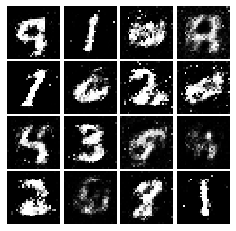


Iter: 2750, D: 1.199, G:0.9826


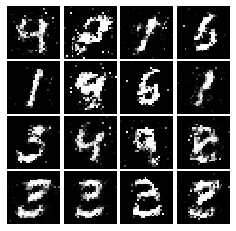


Saving the model as a checkpoint...
EPOCH:  7
Iter: 3000, D: 1.193, G:1.093


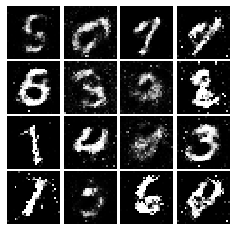


Iter: 3250, D: 1.222, G:1.025


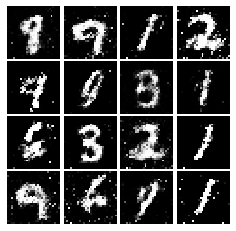


Saving the model as a checkpoint...
EPOCH:  8
Iter: 3500, D: 1.243, G:0.9302


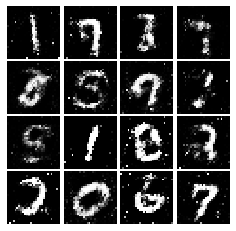


Saving the model as a checkpoint...
EPOCH:  9
Iter: 3750, D: 1.249, G:0.8388


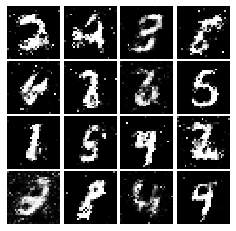


Iter: 4000, D: 1.394, G:0.7189


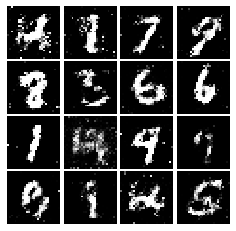


Saving the model as a checkpoint...
EPOCH:  10
Iter: 4250, D: 1.303, G:0.8478


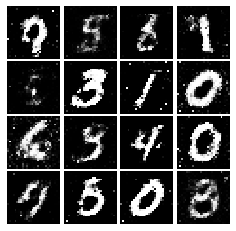


Iter: 4500, D: 1.368, G:0.8276


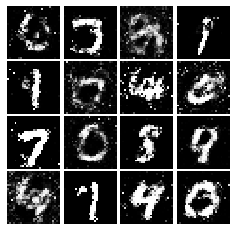


Saving the model as a checkpoint...


In [9]:
# Add training code here:
D = discriminator()
G = generator()


D_solver = torch.optim.Adam(D.parameters(), lr=1e-3, betas = (0.5, 0.999))
G_solver = torch.optim.Adam(G.parameters(), lr=1e-3, betas = (0.5, 0.999))

D.to(device)
G.to(device)

D.train()
G.train()

train(D, G, D_solver, G_solver, discriminator_loss, generator_loss, train_loader=loader_train, device=device)

## Section 1.2 Least-square GAN Loss
### Section 1.2.1 LSGAN Loss [10 pts]
We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$
Fill in the `ls_discriminator_loss` and `ls_generator_loss` in the cell below.

**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [10]:
def ls_discriminator_loss(logits_real, logits_fake):
    """
    Compute the Least-Squares GAN loss for the discriminator.

    Inputs:
    - scores_real: PyTorch Tensor of shape (N,) giving scores for the real data.
    - scores_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
 
    Outputs:
    - loss: A PyTorch Tensor containing the loss.
    """
 
    loss = None
    
    ####################################
    #          YOUR CODE HERE          #
    ####################################
    
    loss_fn = torch.nn.MSELoss()

    shape = (logits_real.shape[0], logits_real.shape[1])

    loss_real = 0.5*loss_fn(logits_real, torch.ones(shape, device=device))

    loss_fake = 0.5*loss_fn(logits_fake, torch.zeros(shape, device=device))

    loss = loss_real + loss_fake

    ##########       END      ##########
    return loss

def ls_generator_loss(logits_fake):
    """
    Computes the Least-Squares GAN loss for the generator.
 
    Inputs:
    - scores_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
 
    Outputs:
    - loss: A PyTorch Tensor containing the loss.
    """

    loss = None
 
    ####################################
    #          YOUR CODE HERE          #
    ####################################
    
    loss_fn = torch.nn.MSELoss()
    
    shape = (logits_fake.shape[0], logits_fake.shape[1])

    loss = loss_fn(logits_fake, torch.ones(shape, device=device))
    
    ##########       END      ##########
    return loss    

### Section 1.2.2 Train model with LSGAN loss[7 pts]

- Call Discriminator and Generator for training.
- Call optimizers for both discriminator and generator for training. (Use Adam with lr=1e-3, betas = (0.5, 0.999))
- Call train function to train. 
- Train for 10 epochs.

Similarly, train your LSGAN on MNIST dataset. You should expect results that resemble the following if your loss function and training loop implementations are correct:

<img src="files/gan_samples/mnist_ls.jpg" width=300>

EPOCH:  1
Iter: 0, D: 0.5569, G:0.9689


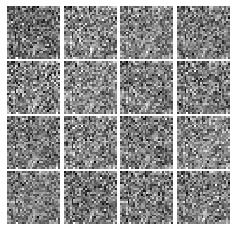


Iter: 250, D: 0.08694, G:0.8005


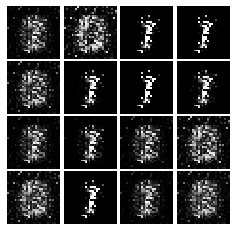


Saving the model as a checkpoint...
EPOCH:  2
Iter: 500, D: 0.1032, G:1.582


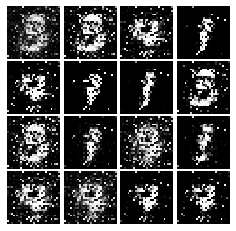


Iter: 750, D: 0.1559, G:0.4729


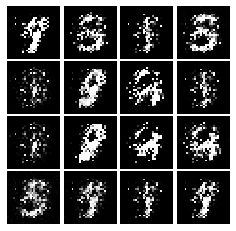


Saving the model as a checkpoint...
EPOCH:  3
Iter: 1000, D: 0.1081, G:0.8692


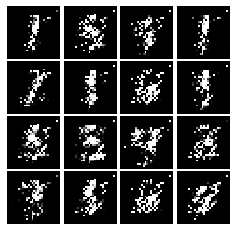


Iter: 1250, D: 0.1338, G:0.698


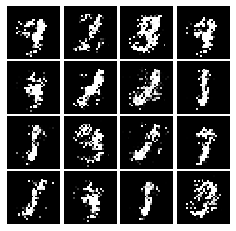


Saving the model as a checkpoint...
EPOCH:  4
Iter: 1500, D: 0.09394, G:0.5748


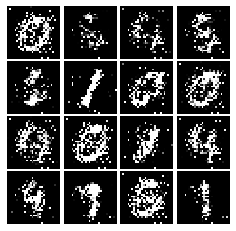


Iter: 1750, D: 0.1753, G:0.5802


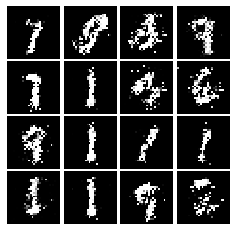


Saving the model as a checkpoint...
EPOCH:  5
Iter: 2000, D: 0.1814, G:0.4506


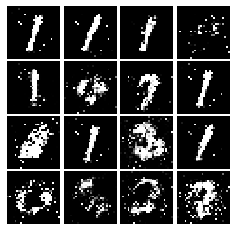


Iter: 2250, D: 0.1941, G:0.3939


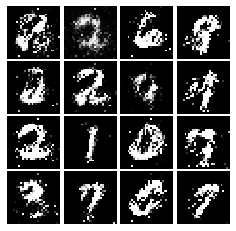


Saving the model as a checkpoint...
EPOCH:  6
Iter: 2500, D: 0.2147, G:0.4292


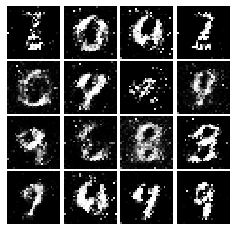


Iter: 2750, D: 0.23, G:0.3328


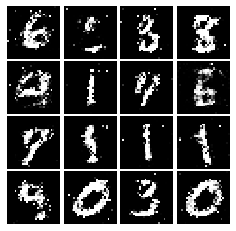


Saving the model as a checkpoint...
EPOCH:  7
Iter: 3000, D: 0.2252, G:0.3956


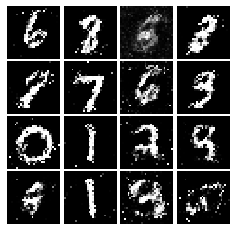


Iter: 3250, D: 0.2172, G:0.408


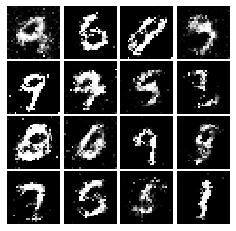


Saving the model as a checkpoint...
EPOCH:  8
Iter: 3500, D: 0.2569, G:0.2622


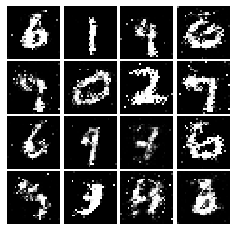


Saving the model as a checkpoint...
EPOCH:  9
Iter: 3750, D: 0.2156, G:0.3156


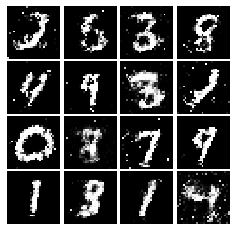


Iter: 4000, D: 0.2242, G:0.2893


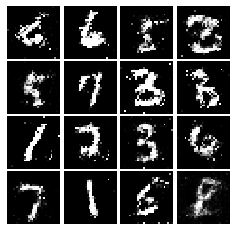


Saving the model as a checkpoint...
EPOCH:  10
Iter: 4250, D: 0.2098, G:0.3241


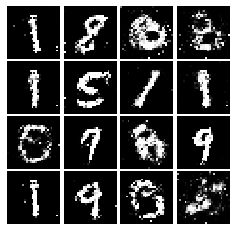


Iter: 4500, D: 0.218, G:0.3852


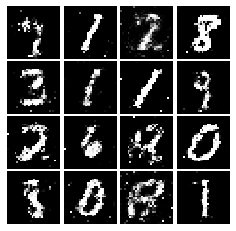


Saving the model as a checkpoint...


In [11]:
# YOUR TRAINING CODE HERE

D = discriminator()
G = generator()


D_solver = torch.optim.Adam(D.parameters(), lr=1e-3, betas = (0.5, 0.999))
G_solver = torch.optim.Adam(G.parameters(), lr=1e-3, betas = (0.5, 0.999))

D.to(device)
G.to(device)

D.train()
G.train()

train(D, G, D_solver, G_solver, ls_discriminator_loss, ls_generator_loss, train_loader=loader_train, device=device)

# Section 2. Generative Adversarial Networks on CelebA Dataset [56 pts]

In this section, you will need to:
1. Implement DCGAN architecture
2. Train it on CelebA dataset.

We are done with the simple, not-so-challenging MNIST dataset. Now, you need to implement a specific model architecture called [DCGAN](https://arxiv.org/pdf/1511.06434.pdf), and train your model to generate human faces!

### Section 2.1. GAN model architecture [20 pts]

Implement your generator and discriminator for generating faces. We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):
**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Instead of Relu we use LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). 

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [12]:
# YOUR GENERATOR/DISCRIMINATOR HERE

class Generator(nn.Module):
    
    def __init__(self, NOISE_DIM):
        super(Generator, self).__init__()
        
        
        self.conv1 = nn.ConvTranspose2d(in_channels=NOISE_DIM, out_channels=1024, kernel_size=4, stride=1)
        self.bn1 = nn.BatchNorm2d(1024)

        self.conv2 = nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=4, stride=2, padding=1)
        self.bn2 = nn.BatchNorm2d(512)

        self.conv3 = nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1)
        self.bn3 = nn.BatchNorm2d(256)

        self.conv4 = nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1)
        self.bn4 = nn.BatchNorm2d(128)

        self.conv5 = nn.ConvTranspose2d(in_channels=128, out_channels=3, kernel_size=4, stride=2, padding=1)
        self.tanh = nn.Tanh()
        
        self.relu = nn.ReLU()
        
    def forward(self, x):
        
        x = x.view(128,100, 1, 1)
        h0 = self.relu(self.bn1(self.conv1(x)))
        h1 = self.relu(self.bn2(self.conv2(h0)))
        h2 = self.relu(self.bn3(self.conv3(h1)))
        h3 = self.relu(self.bn4(self.conv4(h2)))
        out = self.tanh(self.conv5(h3))
        
        return out

class Discriminator(nn.Module):
    
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=128, kernel_size=4, stride=2, padding=1)
        
        self.conv2 = nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1)
        self.bn1 = nn.BatchNorm2d(num_features=256)
        
        self.conv3 = nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1)
        self.bn2 = nn.BatchNorm2d(num_features=512)
        
        self.conv4 = nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=4, stride=2, padding=1)
        self.bn3 = nn.BatchNorm2d(num_features=1024)
        
        self.conv5 = nn.Conv2d(in_channels=1024, out_channels=1, kernel_size=4, stride=1)
        
        self.leaky_relu = nn.LeakyReLU(0.2)
    
    def forward(self, x):
        x = x.view(128, 3, 64, 64)

        h0 = self.leaky_relu(self.conv1(x))
        h1 = self.leaky_relu(self.bn1(self.conv2(h0)))
        h2 = self.leaky_relu(self.bn2(self.conv3(h1)))
        h3 = self.leaky_relu(self.bn3(self.conv4(h2)))
        out = self.conv5(h3)
        
        return out.view(128, 1)

### Section 2.2 Data loading: Celeb A Dataset

The CelebA images we provide have been filtered to obtain only images with clear faces and have been cropped and downsampled to 128x128 resolution.

Run download_celeba.sh to get dataset.

In [13]:
batch_size = 128
scale_size = 64  # We resize the images to 64x64 for training

celeba_root = 'celeba_data'

In [14]:
celeba_train = ImageFolder(root=celeba_root, transform=transforms.Compose([
  transforms.Resize(scale_size),
  transforms.ToTensor(),
]))

# You can change the num_workers to speed up loading
celeba_loader_train = DataLoader(celeba_train, batch_size=batch_size, drop_last=True)

#### Visualize dataset

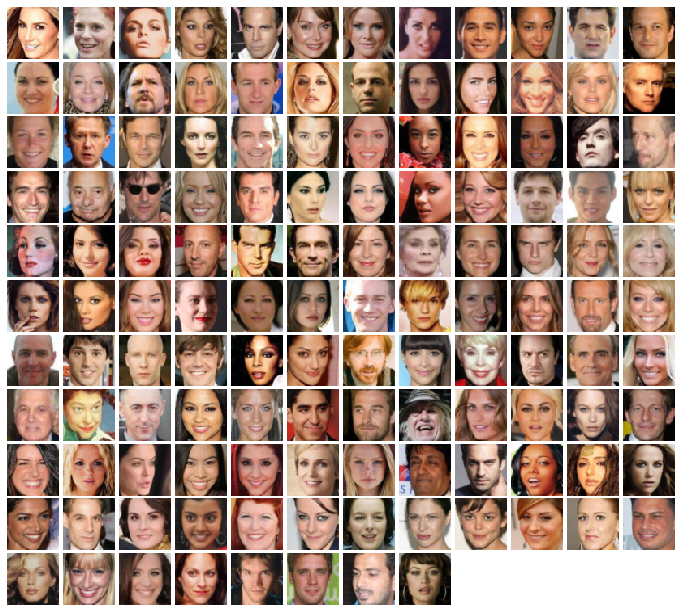

In [15]:
imgs = celeba_loader_train.__iter__().next()[0].numpy().squeeze()
show_images(imgs, color=True)

### Section 2.3 Train a Vanilla GAN on CelebA [13 pts]

- Call discriminator and generator for training.
- Call optimizers for both discriminator and generator for training. (Use Adam with betas = (0.5, 0.999))
- Call train function to train. 
- Train for 30 epochs.

Now, train your GAN model with vanilla GAN loss. If you models are implemented correctly, you should see something like this:
<img src="files/gan_samples/celeba.jpg" width=300>


Now, train your model. **Observe the visualized result of your model, and describe what you see.**

In [16]:
NOISE_DIM = 100
NUM_EPOCHS = 30
learning_rate = 0.0002

EPOCH:  1
Iter: 0, D: 1.641, G:10.45


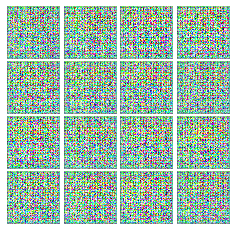


Iter: 250, D: 0.5794, G:4.896


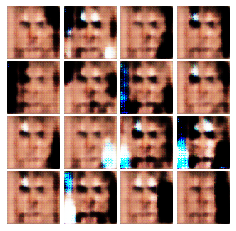


Iter: 500, D: 0.4779, G:2.193


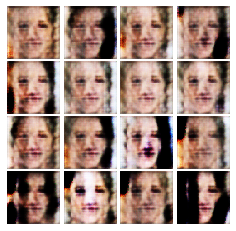


Iter: 750, D: 0.899, G:6.374


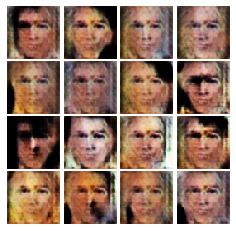


Saving the model as a checkpoint...
EPOCH:  2
Iter: 1000, D: 0.5494, G:0.7017


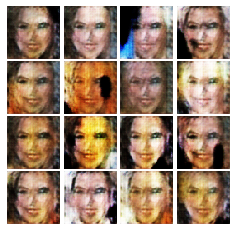


Iter: 1250, D: 0.1949, G:3.343


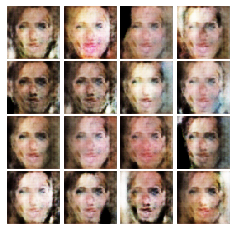


Iter: 1500, D: 0.3677, G:4.617


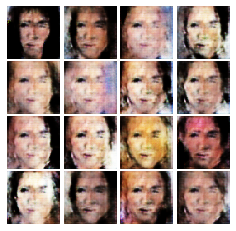


Iter: 1750, D: 0.1927, G:5.075


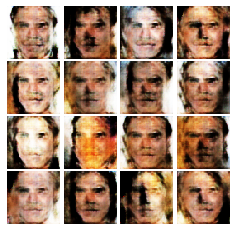


Saving the model as a checkpoint...
EPOCH:  3
Iter: 2000, D: 0.7976, G:5.031


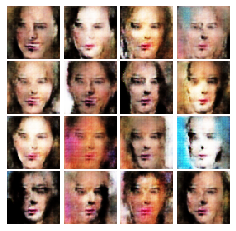


Iter: 2250, D: 0.3223, G:5.848


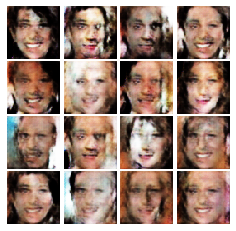


Iter: 2500, D: 3.814, G:5.397


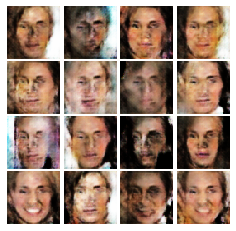


Iter: 2750, D: 0.312, G:4.584


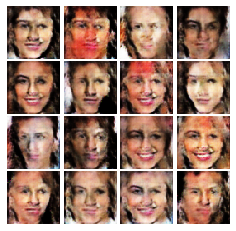


Saving the model as a checkpoint...
EPOCH:  4
Iter: 3000, D: 0.3286, G:5.901


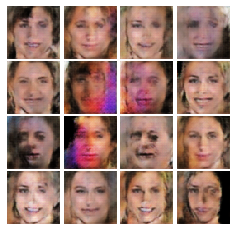


Iter: 3250, D: 0.3916, G:3.926


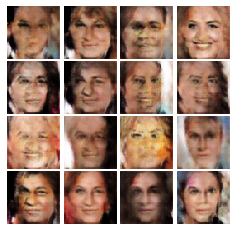


Iter: 3500, D: 0.4839, G:3.957


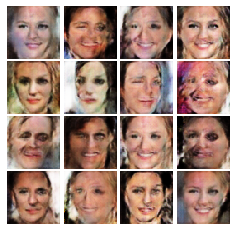


Iter: 3750, D: 0.3904, G:3.588


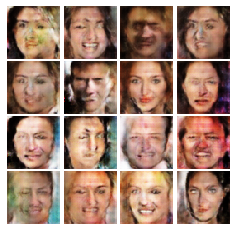


Saving the model as a checkpoint...
EPOCH:  5
Iter: 4000, D: 0.9241, G:5.979


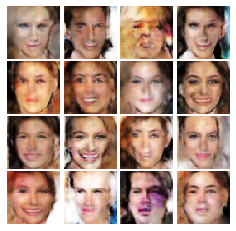


Iter: 4250, D: 0.4473, G:5.322


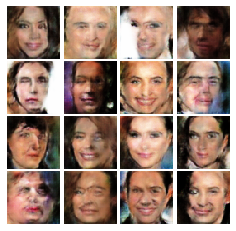


Iter: 4500, D: 0.4255, G:6.581


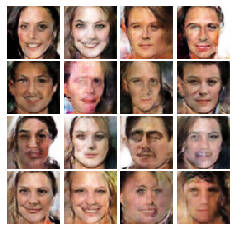


Iter: 4750, D: 0.3838, G:4.07


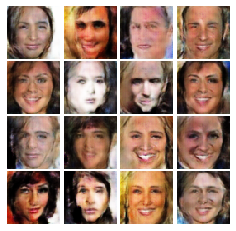


Saving the model as a checkpoint...
EPOCH:  6
Iter: 5000, D: 0.3085, G:6.115


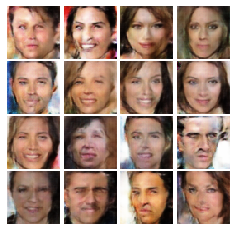


Iter: 5250, D: 0.3747, G:4.326


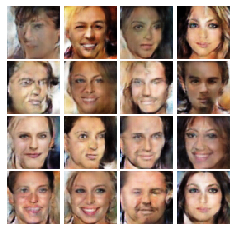


Iter: 5500, D: 0.758, G:2.641


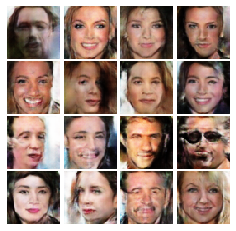


Iter: 5750, D: 1.474, G:1.987


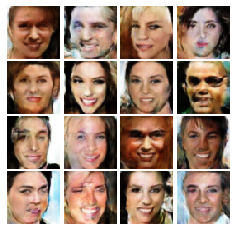


Saving the model as a checkpoint...
EPOCH:  7
Iter: 6000, D: 1.494, G:1.5


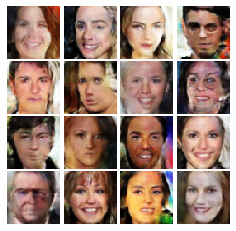


Iter: 6250, D: 0.2669, G:3.084


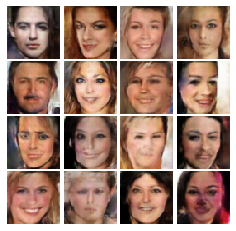


Iter: 6500, D: 0.662, G:1.796


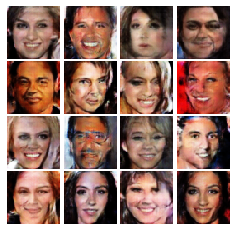


Iter: 6750, D: 0.2655, G:2.944


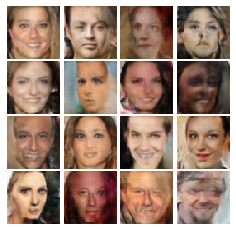


Saving the model as a checkpoint...
EPOCH:  8
Iter: 7000, D: 0.3875, G:3.506


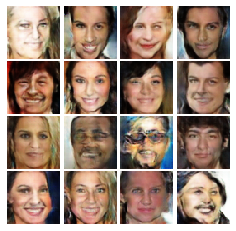


Iter: 7250, D: 0.3422, G:3.737


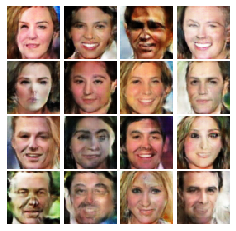


Iter: 7500, D: 0.5836, G:4.178


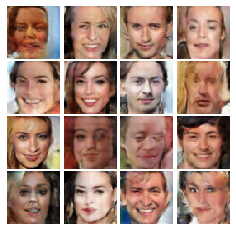


Iter: 7750, D: 0.4554, G:4.585


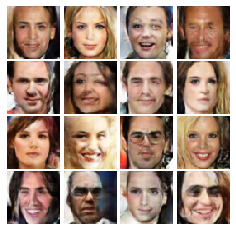


Saving the model as a checkpoint...
EPOCH:  9
Iter: 8000, D: 0.3251, G:2.226


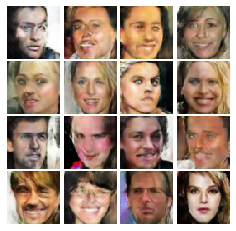


Iter: 8250, D: 0.2554, G:3.844


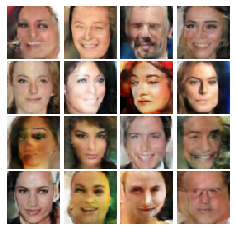


Iter: 8500, D: 0.4326, G:3.18


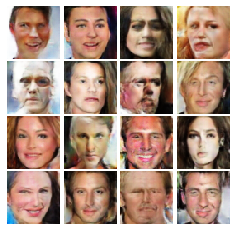


Iter: 8750, D: 0.233, G:4.13


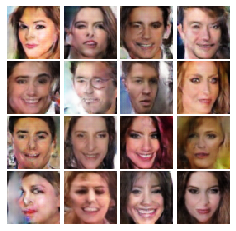


Saving the model as a checkpoint...
EPOCH:  10
Iter: 9000, D: 0.8357, G:7.906


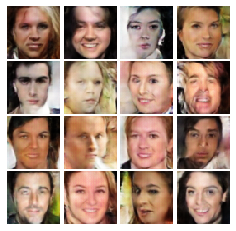


Iter: 9250, D: 1.124, G:11.39


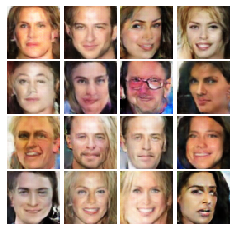


Iter: 9500, D: 0.2008, G:3.63


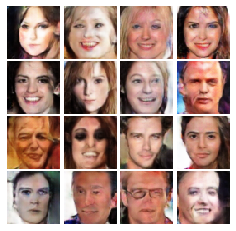


Iter: 9750, D: 0.2958, G:6.785


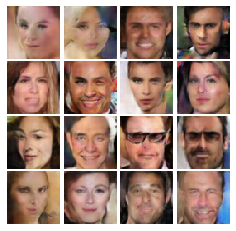


Saving the model as a checkpoint...
EPOCH:  11
Iter: 10000, D: 0.2683, G:4.184


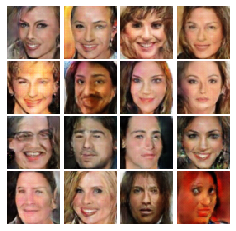


Iter: 10250, D: 0.3335, G:6.218


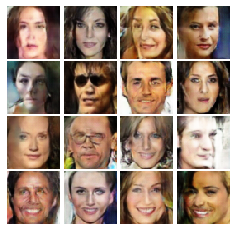


Iter: 10500, D: 0.209, G:5.635


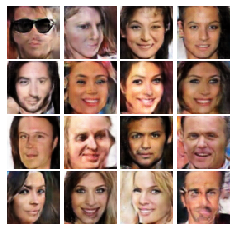


Iter: 10750, D: 0.7299, G:8.36


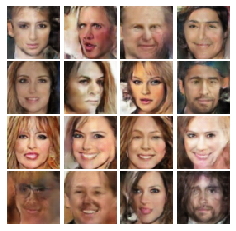


Saving the model as a checkpoint...
EPOCH:  12
Iter: 11000, D: 0.2985, G:3.274


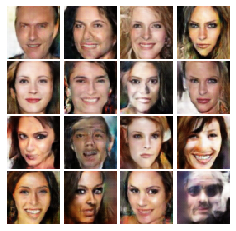


Iter: 11250, D: 0.1254, G:4.433


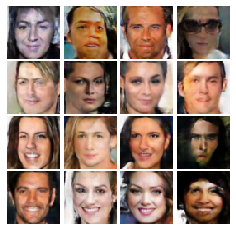


Iter: 11500, D: 0.1283, G:4.349


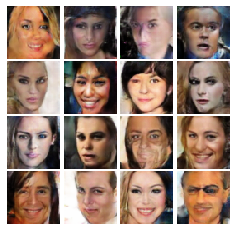


Iter: 11750, D: 0.7244, G:4.018


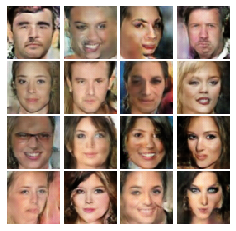


Saving the model as a checkpoint...
EPOCH:  13
Iter: 12000, D: 0.1482, G:4.587


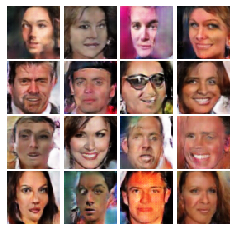


Iter: 12250, D: 0.8646, G:2.621


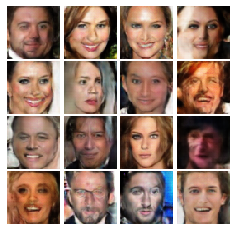


Iter: 12500, D: 0.191, G:4.388


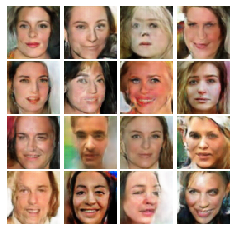


Iter: 12750, D: 0.1299, G:5.722


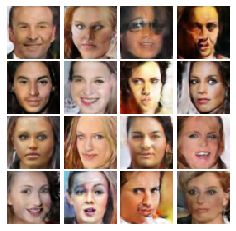


Saving the model as a checkpoint...
EPOCH:  14
Iter: 13000, D: 0.1204, G:6.434


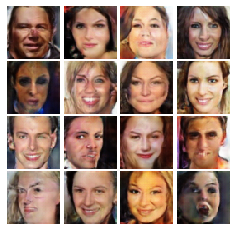


Iter: 13250, D: 0.1927, G:4.462


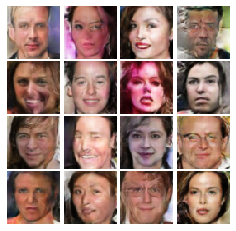


Iter: 13500, D: 0.1056, G:5.777


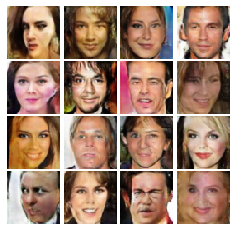


Iter: 13750, D: 0.1142, G:5.78


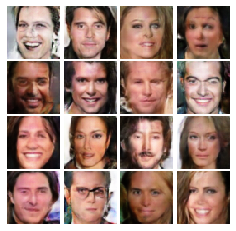


Saving the model as a checkpoint...
EPOCH:  15
Iter: 14000, D: 0.5863, G:9.405


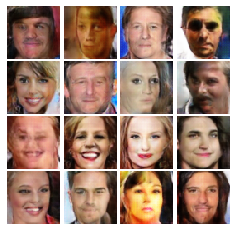


Iter: 14250, D: 0.6236, G:3.967


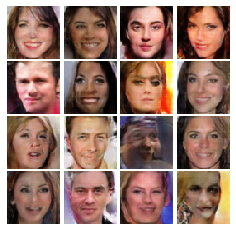


Iter: 14500, D: 0.226, G:5.591


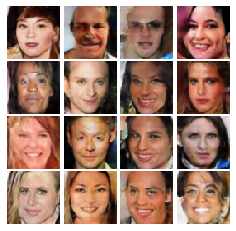


Iter: 14750, D: 0.3075, G:9.649


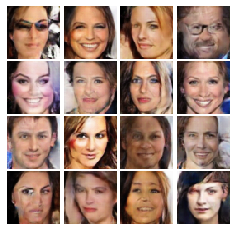


Saving the model as a checkpoint...
EPOCH:  16
Iter: 15000, D: 0.4827, G:4.138


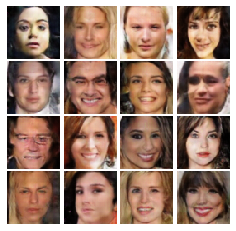


Iter: 15250, D: 0.09843, G:4.35


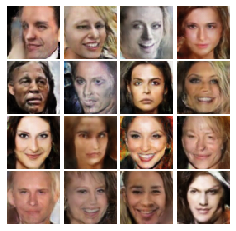


Iter: 15500, D: 0.1882, G:5.188


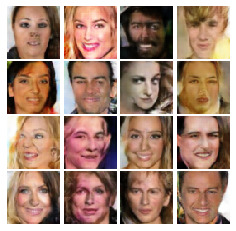


Iter: 15750, D: 0.1517, G:5.669


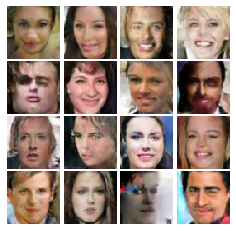


Saving the model as a checkpoint...
EPOCH:  17
Iter: 16000, D: 0.3568, G:4.896


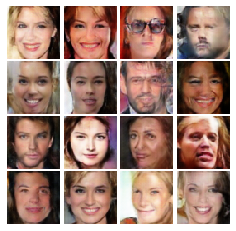


Iter: 16250, D: 0.2398, G:4.099


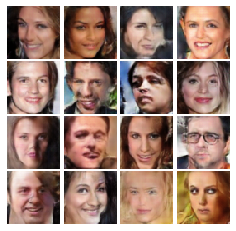


Iter: 16500, D: 0.06609, G:5.58


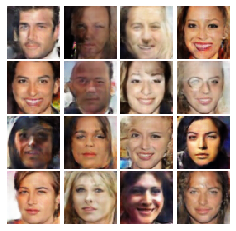


Iter: 16750, D: 0.114, G:6.724


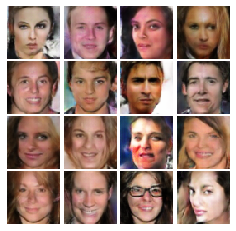


Saving the model as a checkpoint...
EPOCH:  18
Iter: 17000, D: 0.2948, G:1.519


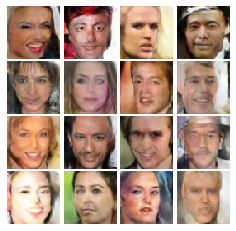


Iter: 17250, D: 0.1033, G:4.32


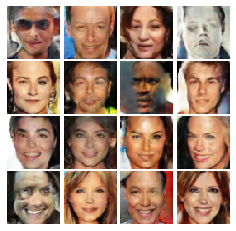


Iter: 17500, D: 0.1549, G:3.629


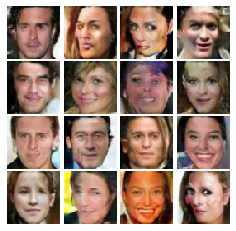


Saving the model as a checkpoint...
EPOCH:  19
Iter: 17750, D: 0.07947, G:5.08


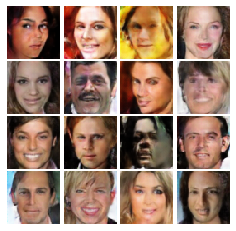


Iter: 18000, D: 0.1146, G:4.043


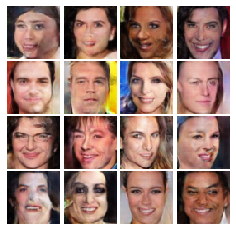


Iter: 18250, D: 0.1088, G:4.771


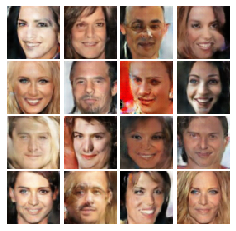


Iter: 18500, D: 0.4734, G:7.557


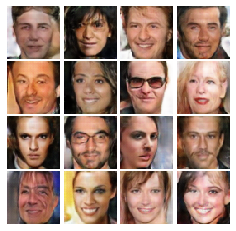


Saving the model as a checkpoint...
EPOCH:  20
Iter: 18750, D: 0.1003, G:6.294


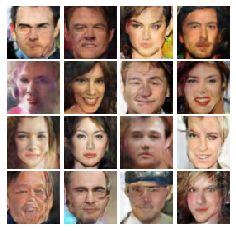


Iter: 19000, D: 0.6418, G:7.918


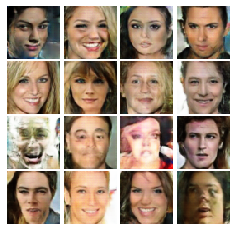


Iter: 19250, D: 3.26, G:1.289


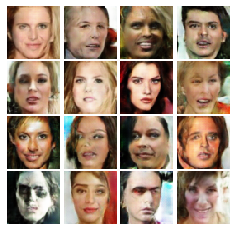


Iter: 19500, D: 0.09145, G:4.046


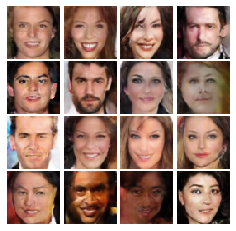


Saving the model as a checkpoint...
EPOCH:  21
Iter: 19750, D: 0.07567, G:4.864


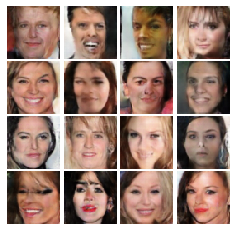


Iter: 20000, D: 0.2439, G:4.664


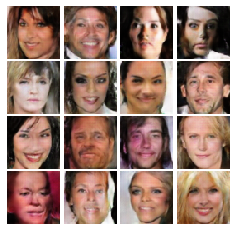


Iter: 20250, D: 0.1407, G:5.038


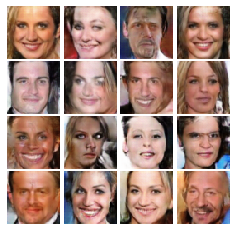


Iter: 20500, D: 0.06011, G:5.449


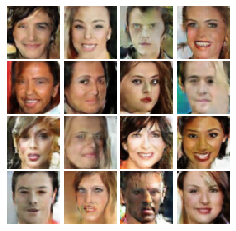


Saving the model as a checkpoint...
EPOCH:  22
Iter: 20750, D: 0.05682, G:5.159


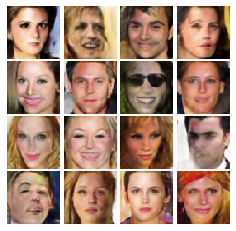


Iter: 21000, D: 0.1035, G:4.686


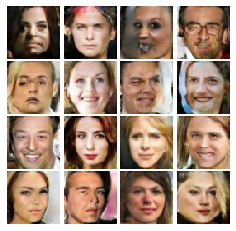


Iter: 21250, D: 0.03724, G:5.709


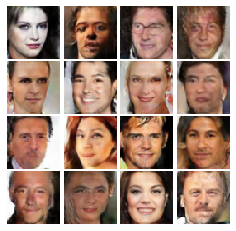


Iter: 21500, D: 0.03258, G:4.973


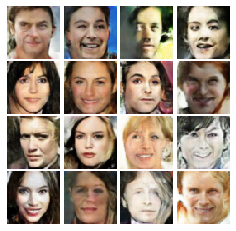


Saving the model as a checkpoint...
EPOCH:  23
Iter: 21750, D: 0.7671, G:4.66


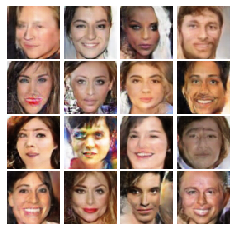


Iter: 22000, D: 0.1501, G:4.229


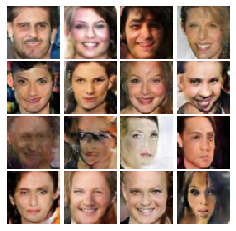


Iter: 22250, D: 0.1117, G:5.214


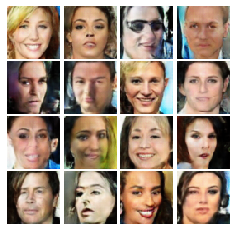


Iter: 22500, D: 0.02615, G:6.743


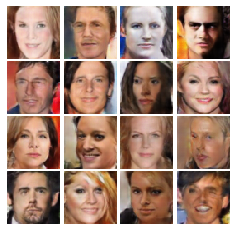


Saving the model as a checkpoint...
EPOCH:  24
Iter: 22750, D: 0.4665, G:6.549


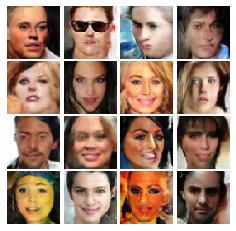


Iter: 23000, D: 0.5325, G:8.375


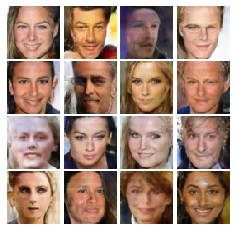


Iter: 23250, D: 0.05479, G:5.029


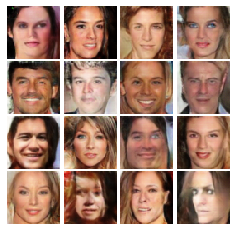


Iter: 23500, D: 0.03391, G:6.099


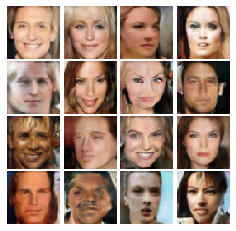


Saving the model as a checkpoint...
EPOCH:  25
Iter: 23750, D: 0.1019, G:4.188


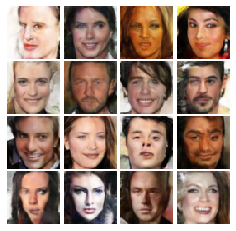


Iter: 24000, D: 0.1746, G:8.205


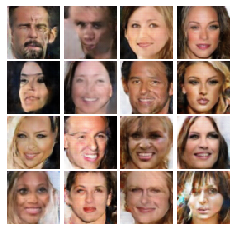


Iter: 24250, D: 0.0524, G:4.592


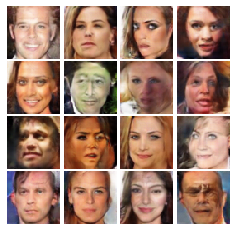


Iter: 24500, D: 0.1023, G:6.37


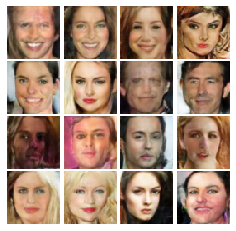


Saving the model as a checkpoint...
EPOCH:  26
Iter: 24750, D: 0.05163, G:5.821


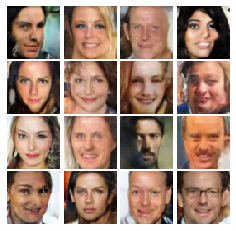


Iter: 25000, D: 0.04593, G:5.586


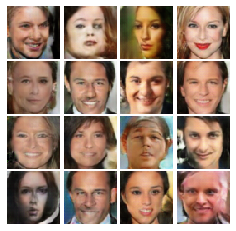


Iter: 25250, D: 0.2732, G:5.379


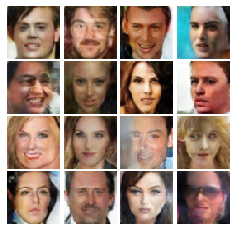


Iter: 25500, D: 0.05048, G:6.712


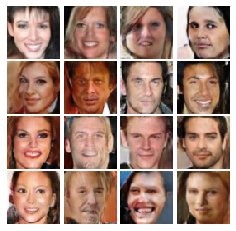


Saving the model as a checkpoint...
EPOCH:  27
Iter: 25750, D: 3.335, G:4.712


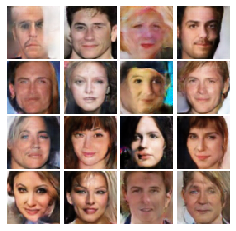


Iter: 26000, D: 0.6416, G:1.579


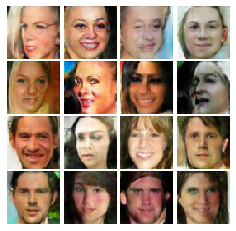


Iter: 26250, D: 0.9025, G:9.392


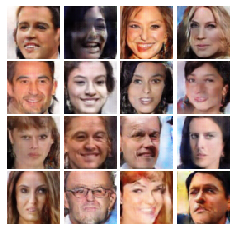


Iter: 26500, D: 0.08388, G:3.952


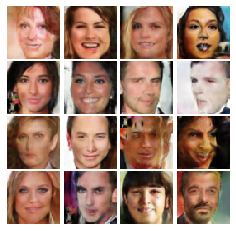


Saving the model as a checkpoint...
EPOCH:  28
Iter: 26750, D: 0.9086, G:4.391


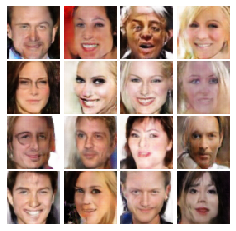


Iter: 27000, D: 0.08572, G:5.781


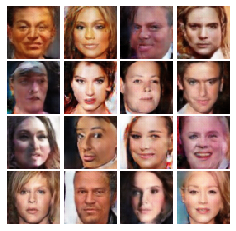


Iter: 27250, D: 0.4953, G:8.739


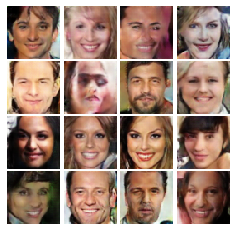


Iter: 27500, D: 0.3092, G:3.908


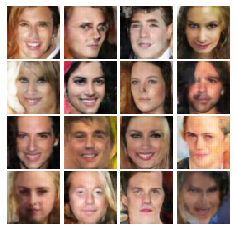


Saving the model as a checkpoint...
EPOCH:  29
Iter: 27750, D: 0.1186, G:5.31


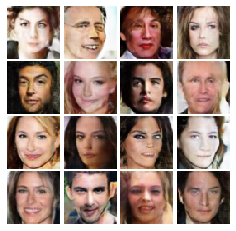


Iter: 28000, D: 0.1039, G:5.167


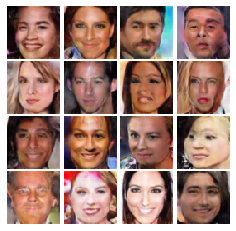


Iter: 28250, D: 0.07323, G:4.519


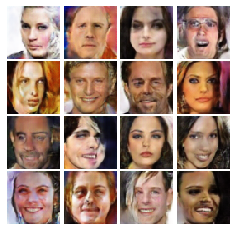


Iter: 28500, D: 0.03486, G:4.643


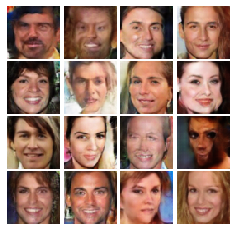


Saving the model as a checkpoint...
EPOCH:  30
Iter: 28750, D: 0.325, G:4.821


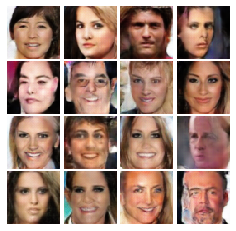


Iter: 29000, D: 0.1261, G:3.5


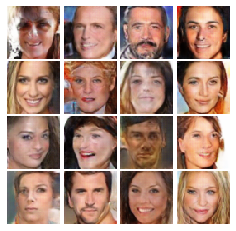


Iter: 29250, D: 0.5349, G:8.054


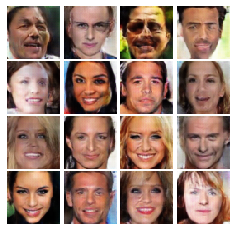


Iter: 29500, D: 0.08197, G:4.568


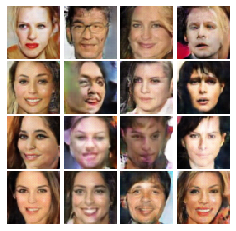


Saving the model as a checkpoint...


In [17]:
# original GAN
# Add code here:

D = Discriminator()
G = Generator(NOISE_DIM)


D_solver = torch.optim.Adam(D.parameters(), betas = (0.5, 0.999))
G_solver = torch.optim.Adam(G.parameters(), betas = (0.5, 0.999))

D.to(device)
G.to(device)

D.train()
G.train()

    
train(D, G, D_solver, G_solver, discriminator_loss, generator_loss, train_loader=celeba_loader_train, device=device, noise_size=NOISE_DIM, num_epochs=30)

**Observation**  
The model produces different faces at the final epoch. Starting from generating some noisy images, we can see some unclear faces in 1st epoch itself.

### Section 2.4 Train a LSGAN on CelebA [13 pts]

- Call discriminator and generator for training.
- Call optimizers for both discriminator and generator for training. (Use Adam with betas = (0.5, 0.999))
- Call train function to train. 
- Train for 30 epochs.

Now, train your GAN model with LSGAN loss. **Observe the visualized result of your model, and describe what you see.**

EPOCH:  1
Iter: 0, D: 0.2366, G:288.5


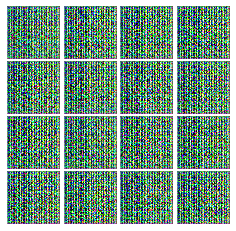


Iter: 250, D: 1.296, G:6.201


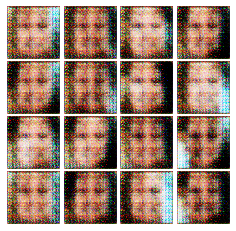


Iter: 500, D: 0.677, G:0.6112


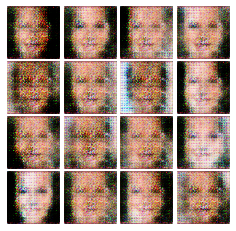


Iter: 750, D: 0.1058, G:0.5475


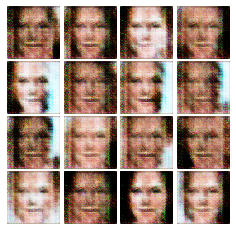


Saving the model as a checkpoint...
EPOCH:  2
Iter: 1000, D: 0.5604, G:0.1402


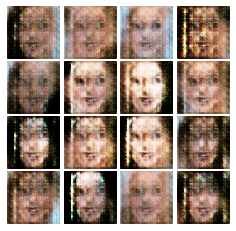


Iter: 1250, D: 0.2078, G:0.6862


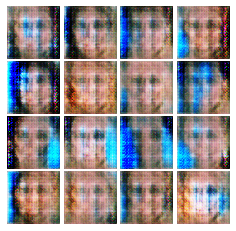


Iter: 1500, D: 0.3659, G:4.576


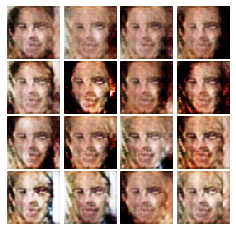


Iter: 1750, D: 0.2181, G:0.6881


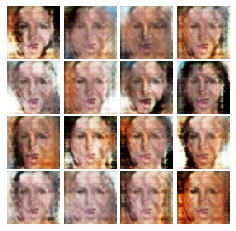


Saving the model as a checkpoint...
EPOCH:  3
Iter: 2000, D: 0.1324, G:0.8004


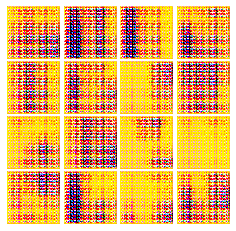


Iter: 2250, D: 0.03702, G:0.697


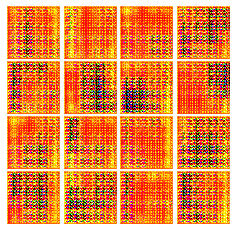


Iter: 2500, D: 0.1467, G:1.261


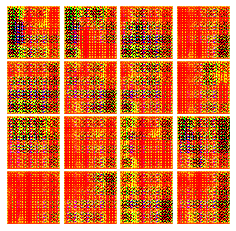


Iter: 2750, D: 0.02676, G:0.9703


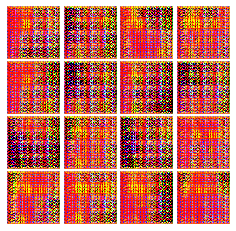


Saving the model as a checkpoint...
EPOCH:  4
Iter: 3000, D: 0.2822, G:3.72


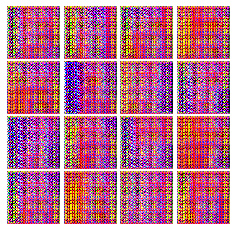


Iter: 3250, D: 0.09116, G:0.483


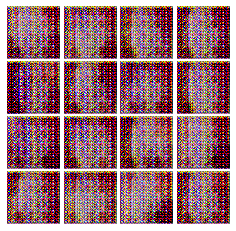


Iter: 3500, D: 0.01273, G:1.036


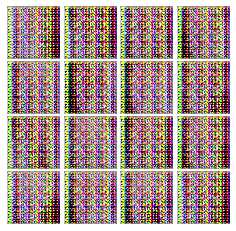


Iter: 3750, D: 0.9923, G:0.3516


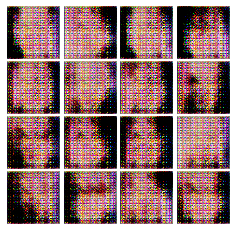


Saving the model as a checkpoint...
EPOCH:  5
Iter: 4000, D: 0.1773, G:0.4448


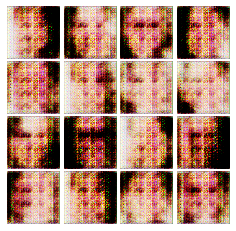


Iter: 4250, D: 0.2664, G:0.5315


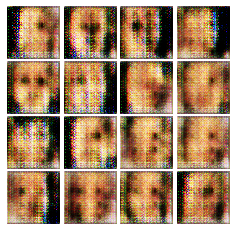


Iter: 4500, D: 0.236, G:0.4389


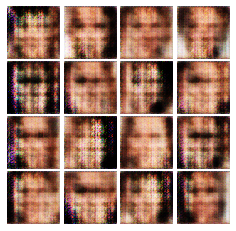


Iter: 4750, D: 0.1765, G:0.9389


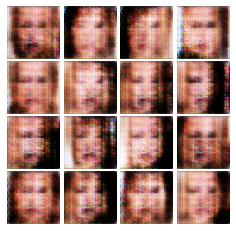


Saving the model as a checkpoint...
EPOCH:  6
Iter: 5000, D: 0.2746, G:0.8395


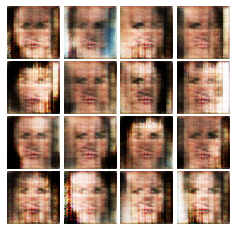


Iter: 5250, D: 0.1221, G:0.5884


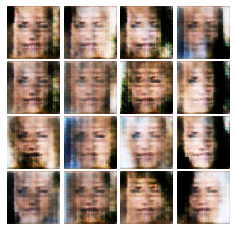


Iter: 5500, D: 0.2561, G:0.7628


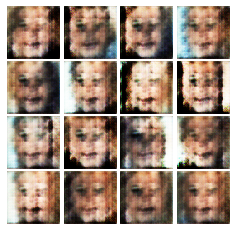


Iter: 5750, D: 0.1205, G:1.094


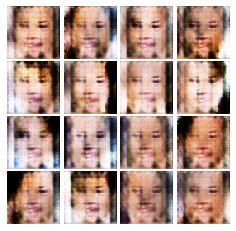


Saving the model as a checkpoint...
EPOCH:  7
Iter: 6000, D: 0.2332, G:0.4085


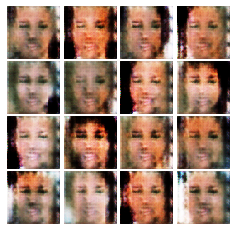


Iter: 6250, D: 0.1823, G:0.7439


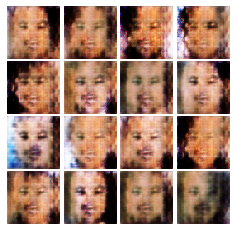


Iter: 6500, D: 0.792, G:0.5351


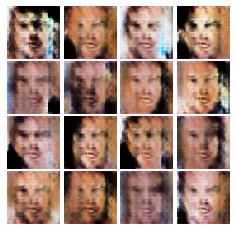


Iter: 6750, D: 0.1536, G:0.4433


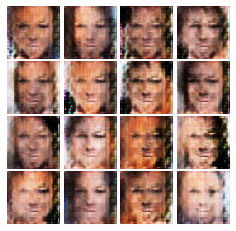


Saving the model as a checkpoint...
EPOCH:  8
Iter: 7000, D: 0.1825, G:0.7143


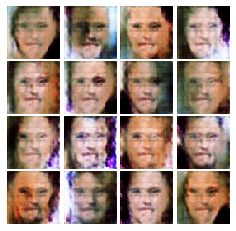


Iter: 7250, D: 0.2266, G:1.082


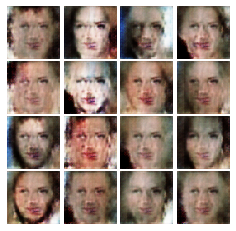


Iter: 7500, D: 0.1976, G:0.8942


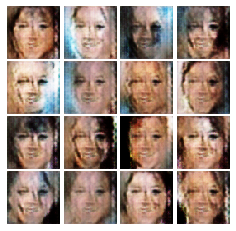


Iter: 7750, D: 0.2821, G:0.8162


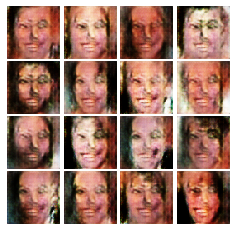


Saving the model as a checkpoint...
EPOCH:  9
Iter: 8000, D: 0.4391, G:0.7555


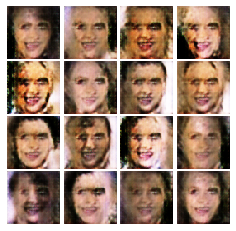


Iter: 8250, D: 0.1739, G:0.8283


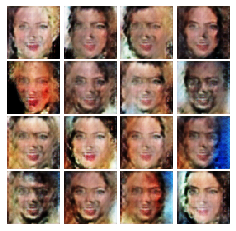


Iter: 8500, D: 0.543, G:0.6863


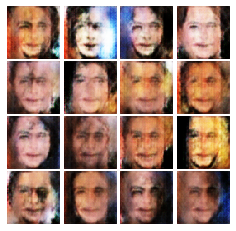


Iter: 8750, D: 0.2657, G:0.453


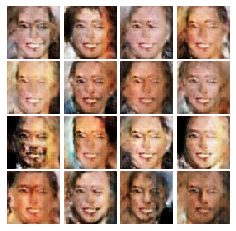


Saving the model as a checkpoint...
EPOCH:  10
Iter: 9000, D: 0.2485, G:0.2904


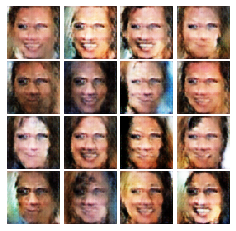


Iter: 9250, D: 0.2091, G:0.7244


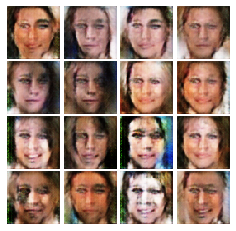


Iter: 9500, D: 0.3655, G:0.4037


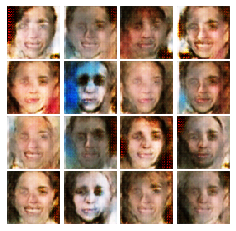


Iter: 9750, D: 0.3012, G:0.9116


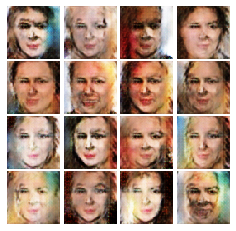


Saving the model as a checkpoint...
EPOCH:  11
Iter: 10000, D: 0.2085, G:0.3113


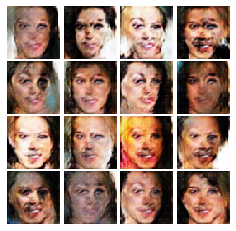


Iter: 10250, D: 0.1517, G:0.5135


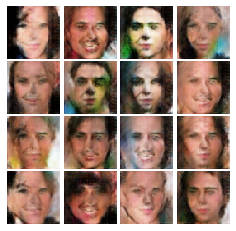


Iter: 10500, D: 0.2047, G:0.8831


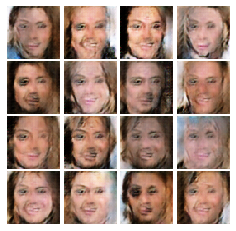


Iter: 10750, D: 0.2067, G:1.074


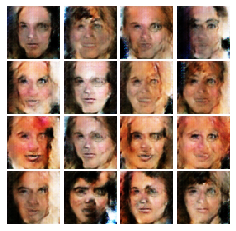


Saving the model as a checkpoint...
EPOCH:  12
Iter: 11000, D: 0.2502, G:0.4802


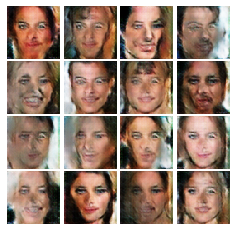


Iter: 11250, D: 0.2167, G:0.5329


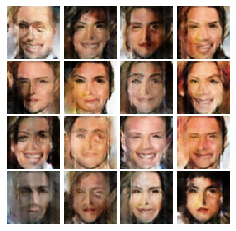


Iter: 11500, D: 0.1792, G:0.3639


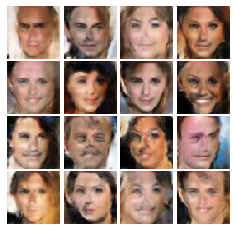


Iter: 11750, D: 0.1945, G:0.5437


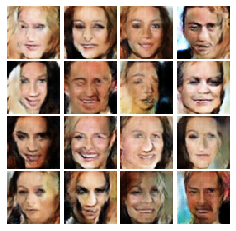


Saving the model as a checkpoint...
EPOCH:  13
Iter: 12000, D: 0.3294, G:0.7087


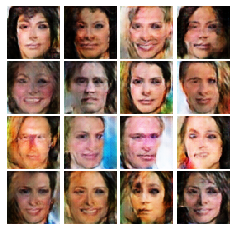


Iter: 12250, D: 0.2006, G:0.4198


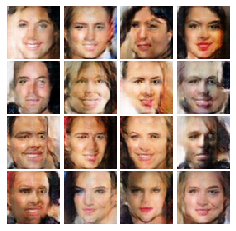


Iter: 12500, D: 0.2609, G:0.8585


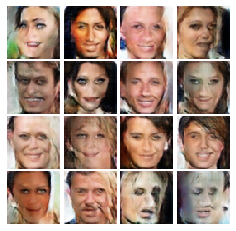


Iter: 12750, D: 0.4607, G:0.08748


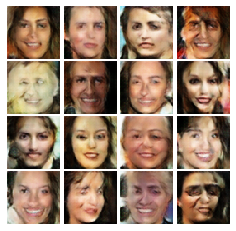


Saving the model as a checkpoint...
EPOCH:  14
Iter: 13000, D: 0.1785, G:0.4301


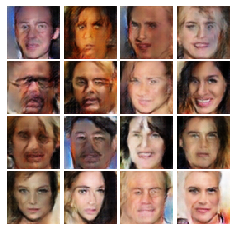


Iter: 13250, D: 0.4059, G:0.8746


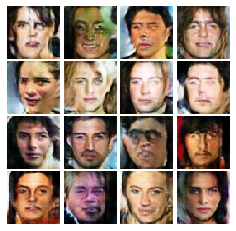


Iter: 13500, D: 0.315, G:0.5714


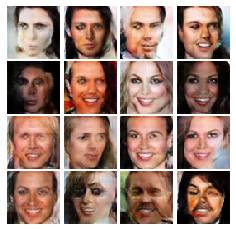


Iter: 13750, D: 0.2486, G:0.2625


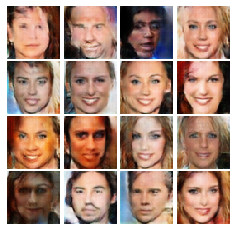


Saving the model as a checkpoint...
EPOCH:  15
Iter: 14000, D: 0.2229, G:0.4747


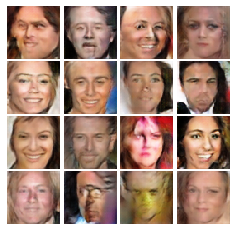


Iter: 14250, D: 0.2096, G:0.538


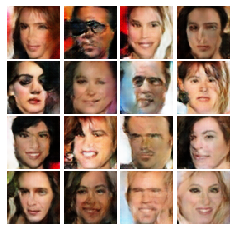


Iter: 14500, D: 0.2237, G:0.3345


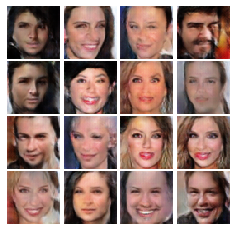


Iter: 14750, D: 0.2391, G:0.3548


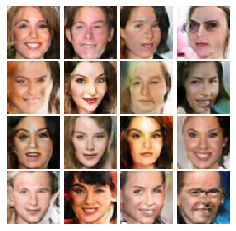


Saving the model as a checkpoint...
EPOCH:  16
Iter: 15000, D: 0.2901, G:0.7579


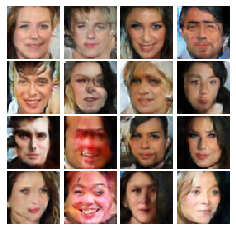


Iter: 15250, D: 0.2184, G:0.5273


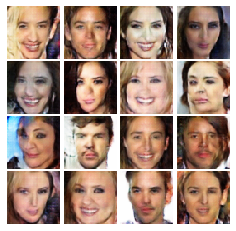


Iter: 15500, D: 0.2505, G:0.3662


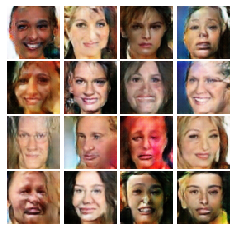


Iter: 15750, D: 0.2629, G:0.3772


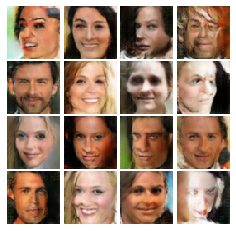


Saving the model as a checkpoint...
EPOCH:  17
Iter: 16000, D: 0.1895, G:0.5306


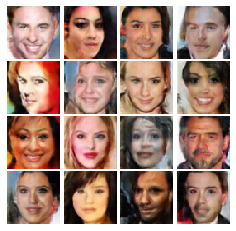


Iter: 16250, D: 0.2294, G:0.2476


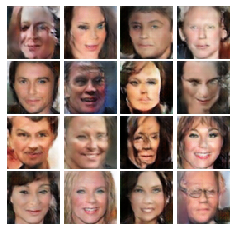


Iter: 16500, D: 0.2131, G:0.5746


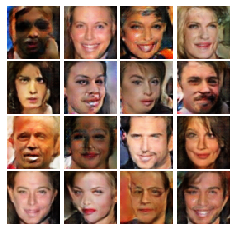


Iter: 16750, D: 0.181, G:0.4689


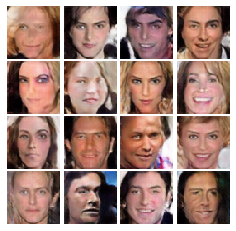


Saving the model as a checkpoint...
EPOCH:  18
Iter: 17000, D: 0.1673, G:0.543


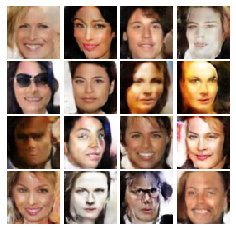


Iter: 17250, D: 0.2605, G:0.5916


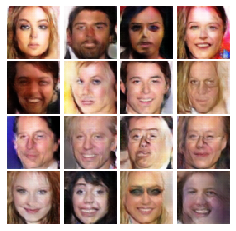


Iter: 17500, D: 0.2714, G:0.7868


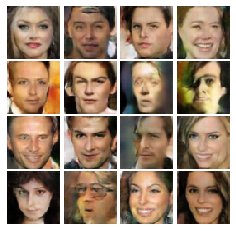


Saving the model as a checkpoint...
EPOCH:  19
Iter: 17750, D: 0.2333, G:0.7025


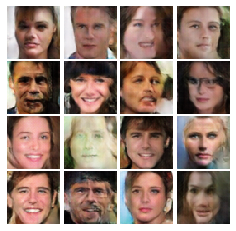


Iter: 18000, D: 0.1841, G:0.3385


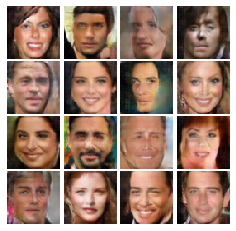


Iter: 18250, D: 0.2045, G:0.3641


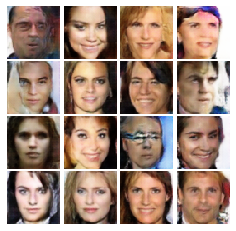


Iter: 18500, D: 0.2378, G:0.3233


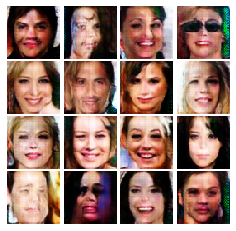


Saving the model as a checkpoint...
EPOCH:  20
Iter: 18750, D: 0.2502, G:0.3376


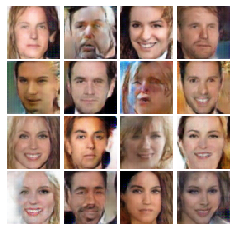


Iter: 19000, D: 0.2311, G:0.2133


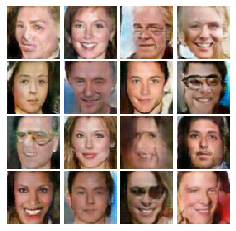


Iter: 19250, D: 0.2572, G:0.258


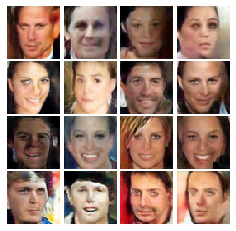


Iter: 19500, D: 0.2501, G:0.2737


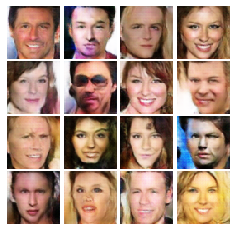


Saving the model as a checkpoint...
EPOCH:  21
Iter: 19750, D: 0.2381, G:0.2921


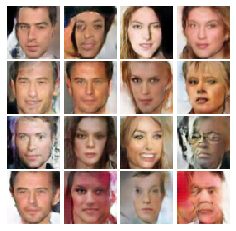


Iter: 20000, D: 0.2284, G:0.4438


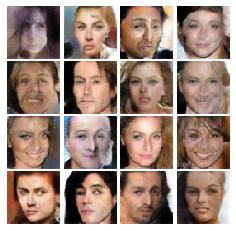


Iter: 20250, D: 0.2569, G:0.3825


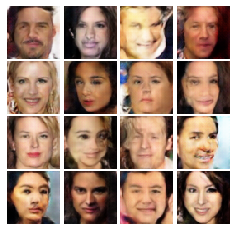


Iter: 20500, D: 0.2202, G:0.4197


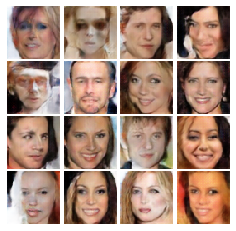


Saving the model as a checkpoint...
EPOCH:  22
Iter: 20750, D: 0.1731, G:0.5307


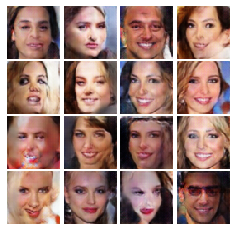


Iter: 21000, D: 0.2134, G:0.3551


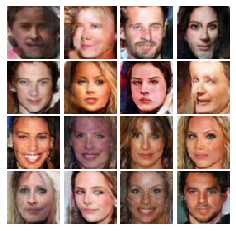


Iter: 21250, D: 0.1814, G:0.7096


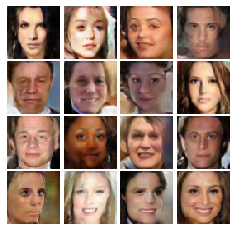


Iter: 21500, D: 0.3629, G:0.7225


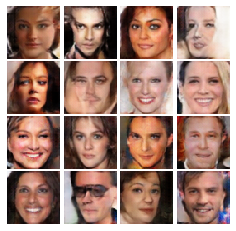


Saving the model as a checkpoint...
EPOCH:  23
Iter: 21750, D: 0.1839, G:0.5129


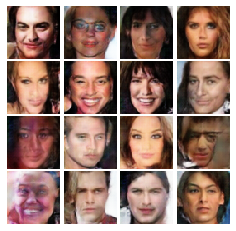


Iter: 22000, D: 0.285, G:1.662


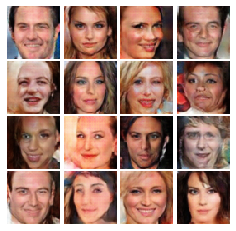


Iter: 22250, D: 0.1364, G:0.4256


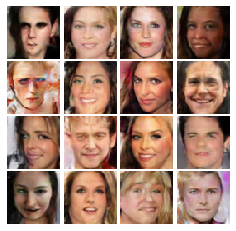


Iter: 22500, D: 0.1174, G:0.8112


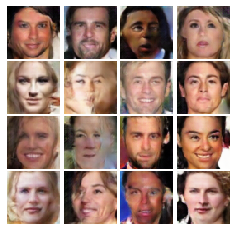


Saving the model as a checkpoint...
EPOCH:  24
Iter: 22750, D: 0.1259, G:0.8259


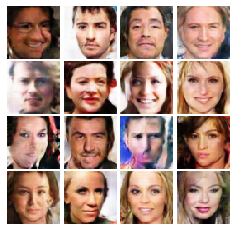


Iter: 23000, D: 0.108, G:0.7398


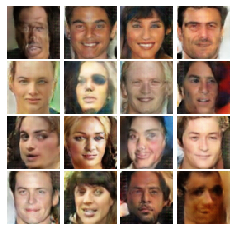


Iter: 23250, D: 0.1255, G:1.126


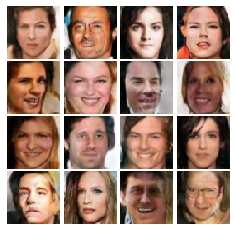


Iter: 23500, D: 0.1208, G:0.6816


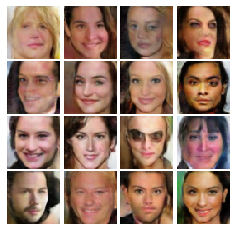


Saving the model as a checkpoint...
EPOCH:  25
Iter: 23750, D: 0.1454, G:0.5788


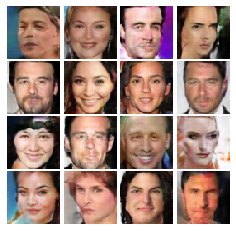


Iter: 24000, D: 0.1412, G:0.7061


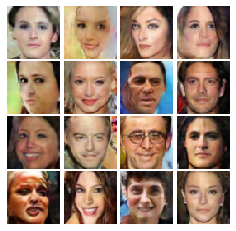


Iter: 24250, D: 0.1086, G:0.5297


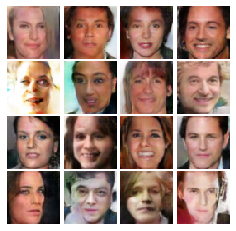


Iter: 24500, D: 0.09806, G:0.4971


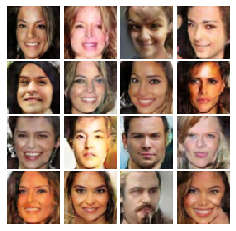


Saving the model as a checkpoint...
EPOCH:  26
Iter: 24750, D: 0.1204, G:0.7891


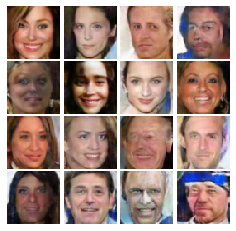


Iter: 25000, D: 0.1501, G:0.5319


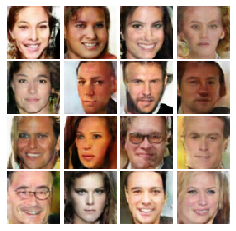


Iter: 25250, D: 0.1029, G:0.7232


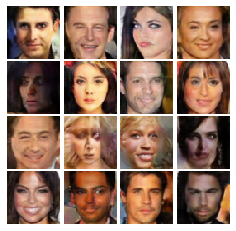


Iter: 25500, D: 0.2184, G:1.531


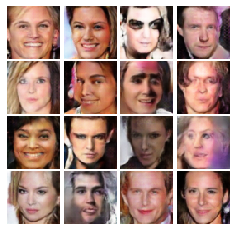


Saving the model as a checkpoint...
EPOCH:  27
Iter: 25750, D: 0.1232, G:0.7593


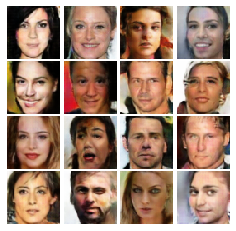


Iter: 26000, D: 0.106, G:0.5267


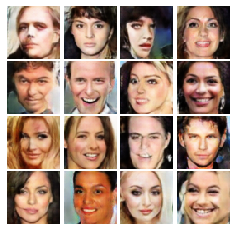


Iter: 26250, D: 0.09805, G:0.7776


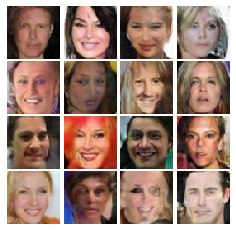


Iter: 26500, D: 0.1382, G:0.6399


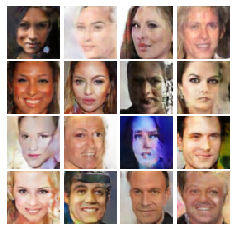


Saving the model as a checkpoint...
EPOCH:  28
Iter: 26750, D: 0.1508, G:0.6044


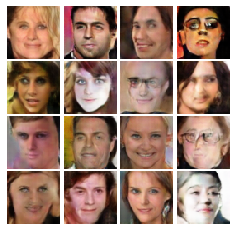


Iter: 27000, D: 0.1478, G:0.5506


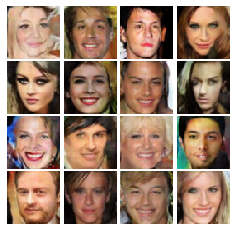


Iter: 27250, D: 0.1278, G:0.9847


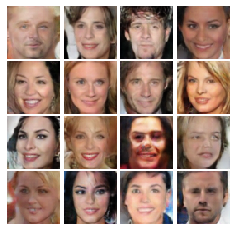


Iter: 27500, D: 0.2241, G:0.2784


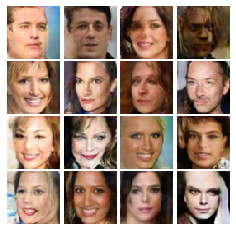


Saving the model as a checkpoint...
EPOCH:  29
Iter: 27750, D: 0.1009, G:0.8134


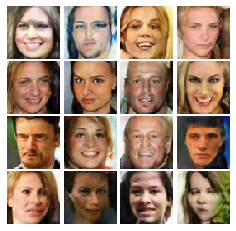


Iter: 28000, D: 0.1251, G:0.3691


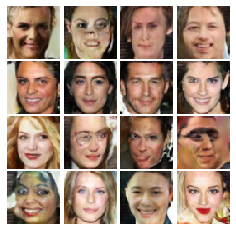


Iter: 28250, D: 0.06441, G:0.8405


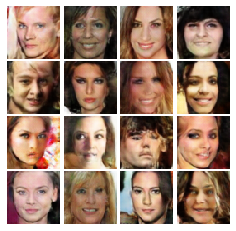


Iter: 28500, D: 0.1074, G:1.146


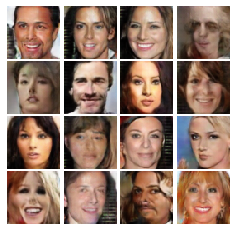


Saving the model as a checkpoint...
EPOCH:  30
Iter: 28750, D: 0.1682, G:1.17


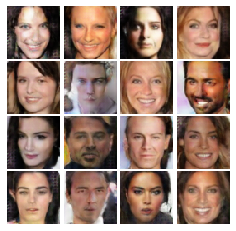


Iter: 29000, D: 0.1414, G:1.103


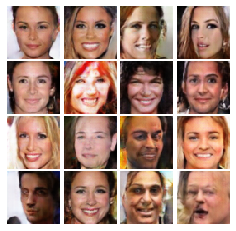


Iter: 29250, D: 0.08942, G:0.606


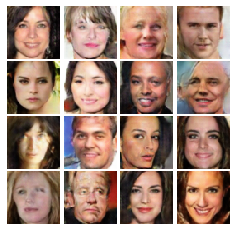


Iter: 29500, D: 0.1491, G:0.4783


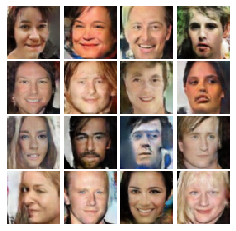


Saving the model as a checkpoint...


In [18]:
# original GAN
# Add code here:

D = Discriminator()
G = Generator(NOISE_DIM)


D_solver = torch.optim.Adam(D.parameters(), lr=1e-3, betas = (0.5, 0.999))
G_solver = torch.optim.Adam(G.parameters(), lr=1e-3, betas = (0.5, 0.999))

D.to(device)
G.to(device)

D.train()
G.train()

train(D, G, D_solver, G_solver, ls_discriminator_loss, ls_generator_loss, train_loader=celeba_loader_train, device=device, noise_size=NOISE_DIM, num_epochs=30)

**Observation**  
We can see from the output of the model improving performance from noise to human faces. In between in the initial epochs, the generator produced some noise, maybe the discriminator was not good enough and it was able to trick the discriminator by producing that noisy output, but as disciminator was getting trained, generator also started producing better faces.

### Section 2.6 Conclusion? [10 pts]
You have successfully trained you GAN models. Hurray! Now, we want you to answer the following question in few sentences.
1. Have you observed any difference between GAN and LSGAN (e.g. training, generation quality)?
2. Did your GAN models generate you diverse faces? Or did it should give you similar stuff all the time?
3. How can you quantitatively evaluate your GAN model? Is the metric(s) meaningful? Is there any drawback about this metric(s)?

**Answers**
1. In early epochs, LSGAN is generating some noisy inputs and is able to fool the discriminator but, GAN is learning properly. The output images after training looks good for both GAN and LSGAN
2. Yes, both the models generate diverse faces.
3. As described in the original GAN paper, GAN model can be quantitively evaluated using Parzen density estimation. This metric is not directly meaningful as in to evaluate the quality of the generated images. This method has somewhat high variance and does not perform well in high dimensional spaces as described in the GAN paper.

### Guidelines for Downloading PDF in Google Colab
- Run below cells only in Google Colab, Comment out in case of Jupyter notebook

In [ ]:
#Run below two lines (in google colab), installation steps to get .pdf of the notebook

!apt-get install texlive texlive-xetex texlive-latex-extra pandoc
!pip install pypandoc

# After installation, comment above two lines and run again to remove installation comments from the notebook.

In [ ]:
# Find path to your notebook file in drive and enter in below line

!jupyter nbconvert --to PDF "your_notebook_path_here/DL_Assignment_5.ipynb"

#Example: "/content/drive/My Drive/DL_Fall_2020/Assignment_5/DL_Assignment_5.ipynb"